# Training Data

The training data is generated using real HSC images from the Ultra Deep (UD) field. The ground truth source detection masks are generated using the [scarlet](https://github.com/pmelchior/scarlet) deblender. HSC UD data can be accessed from https://hsc-release.mtk.nao.ac.jp/doc/index.php/tools-2/. We used the public DR2 UD stacks from: https://hsc-release.mtk.nao.ac.jp/archive/filetree/pdr2_dud/deepCoadd-results. The HSC DR2 data is described in [Hiroaki et al. 2019](https://ui.adsabs.harvard.edu/abs/2019PASJ...71..114A/abstract).

In [1]:
# In case you need to point to pre-existing scarlet install
import sys
sys.path.insert(1, '/home/paleo2/.conda/envs/astro-det-scarlet2/lib/python3.7/site-packages/scarlet-1.0.1+gfde109a-py3.7-linux-ppc64le.egg/')

In [2]:
print(sys.path)

['/home/yufengl2/astrodet/astrodet', '/home/paleo2/.conda/envs/astro-det-scarlet2/lib/python3.7/site-packages/scarlet-1.0.1+gfde109a-py3.7-linux-ppc64le.egg/', '/home/yufengl2/.conda/envs/astro3/lib/python37.zip', '/home/yufengl2/.conda/envs/astro3/lib/python3.7', '/home/yufengl2/.conda/envs/astro3/lib/python3.7/lib-dynload', '', '/home/yufengl2/.conda/envs/astro3/lib/python3.7/site-packages', '/home/yufengl2/.conda/envs/astro3/lib/python3.7/site-packages/locket-0.2.1-py3.7.egg', '/home/yufengl2/.conda/envs/astro3/lib/python3.7/site-packages/IPython/extensions', '/home/yufengl2/.ipython']


In [3]:
# Standard imports
import sys, os
import numpy as np
import time
import glob

import scarlet
import sep

import astropy.io.fits as fits
from astropy.wcs import WCS
from astropy.stats import gaussian_fwhm_to_sigma
from astropy.coordinates import SkyCoord

from scarlet.display import AsinhMapping
from astropy.nddata import Cutout2D

# Astrodet imports
import astrodet.scarlet as sc
from astrodet.hsc import get_tract_patch_from_coord, get_hsc_data

%matplotlib inline
%config InlineBackend.figure_format = 'retina'

import matplotlib
import matplotlib.pyplot as plt

# use a better colormap and don't interpolate the pixels
matplotlib.rc('image', cmap='gray', interpolation='none', origin='lower')

In [4]:
# Print the versions to test the imports and so we know what works
print(scarlet.__version__)
print(np.__version__)
print(sep.__version__)

1.0.1+gfde109a
1.21.5
1.2.1


### Test Scarlet
#### You could skip this module

First, let's test scarlet using one HSC UD image. The HSC image data is divided into "tracts" and "patches" on the sky. You can get the HSC image data given any ra, dec using the code below.

View HSC tract maps: https://hsc-release.mtk.nao.ac.jp/doc/index.php/data/

In [15]:
filters = ['g', 'r', 'i']

# Input coordinate
c = SkyCoord(151.3816, 2.5854, unit='deg')

def generate_training_data_example(c, dirpath='./data/hsc', plot_image=False, plot_stretch_Q=False, plot_scene=True,
                                   plot_likelihood=False, write_results=False, cutout_size=[1024, 1024]):
    """
    Parameters
    ----------
    c : SkyCoord object
          The ra, dec pointing (single or lists of pointings)
    plot_image : bool
          Whether or not to plot the image
    plot_stretch_Q : bool
          Whether or not to plot different normalizations of your image using the stretch, Q parameters.
    plot_scene : bool
           Whether or not plot scene with scarlet
    plot_likelihood : bool
           Whether or not plot the log likelihood of the scarlet fitting
    write_results : bool
          Whether or not to write results to FITS file
    cutout_size : [int, int]
          Cutout shape of image
          
    Returns
    -------
    The scarlet image test in FITS files.
    
    """
    
    # Get the tract, patch
    tract, patch = get_tract_patch_from_coord(c,f='data/hsc/tracts_patches_DUD-XMM-LSS.txt')
    print('\nTract, patch from coord:', tract, patch, "\n")

    # Point to the HSC data directory
    hsc_dirpath = '/home/paleo2/ASTRODET/HSC/hsc-release.mtk.nao.ac.jp/archive/filetree/pdr2_dud/deepCoadd-results/'

    # Get the HSC data from the file info
    # If you want a cutout centered a coordinate, you must pass the coord argument directly into get_hsc_data
    # Otherwise, you can provide patch and tract and the cutout will be centered on the patch image center

    # Warning: Wall time is O(N^3), where N is the image length or width
    datas = get_hsc_data(dirpath=hsc_dirpath, filters=filters, tract=tract,patch=patch, cutout_size=cutout_size)

    # Plot image data
    if plot_image:
        fig, ax = plt.subplots(1, 1, figsize=(9,9))
        norm = scarlet.display.AsinhMapping(minimum=0, stretch=1, Q=5)
        img_rgb = scarlet.display.img_to_rgb(datas, norm=norm)
        ax.imshow(img_rgb)
        ax.axis('off')

    # Find good stretch and Q
    if plot_stretch_Q: fig = sc.plot_stretch_Q(datas);

    ### Run scarlet on image ###

    # HSC pixel scale in arcsec/pixel
    ps = 0.17
    # Approximate PSF size in UD field according to HSC DR2 paper is 0.8 arcsec
    sigma_obs = gaussian_fwhm_to_sigma*0.8/ps
    print(f'\nsigma_obs: {np.around(sigma_obs, 2)} pixels.')
    
    # Run Scarlet
    out = sc.run_scarlet(datas, filters, sigma_model=1, sigma_obs=sigma_obs, plot_scene=plot_scene,
                         max_chi2=1000000, morph_thresh=0.001, starlet_thresh=0.01, stretch=1, Q=5, 
                         plot_wavelet=False, plot_likelihood=plot_likelihood, plot_sources=False, add_ellipses=True,
                         add_labels=False, add_boxes=False, lvl_segmask=2, maskthresh=0.025)

    # Unpack output
    observation, starlet_sources, model_frame, catalog, catalog_deblended, segmentation_masks = out

    # Save Scarlet data to FITS file
    if write_results:
        filenames = sc.write_scarlet_results(datas, observation, starlet_sources, model_frame, 
                                             catalog_deblended, segmentation_masks, dirpath=dirpath, 
                                             filters=filters, s=f'{tract}-{patch[0]},{patch[1]}')
    
        print(f'\nSaved scarlet results as {filenames} \n')


Tract, patch from coord: 9814 (6, 6) 

Overriding tract/patch info and looking for HSC file at requested coordinates.
Loading "/home/paleo2/ASTRODET/HSC/hsc-release.mtk.nao.ac.jp/archive/filetree/pdr2_dud/deepCoadd-results/HSC-G/9814/6,6/calexp-HSC-G-9814-6,6.fits".
Loading "/home/paleo2/ASTRODET/HSC/hsc-release.mtk.nao.ac.jp/archive/filetree/pdr2_dud/deepCoadd-results/HSC-R/9814/6,6/calexp-HSC-R-9814-6,6.fits".
Loading "/home/paleo2/ASTRODET/HSC/hsc-release.mtk.nao.ac.jp/archive/filetree/pdr2_dud/deepCoadd-results/HSC-I/9814/6,6/calexp-HSC-I-9814-6,6.fits".

sigma_obs: 2.0 pixels.
Source catalog found  543 objects
Initializing starlet sources to be fit.
Fitting Blend model.
Scarlet ran for 15 iterations to logL = -2929384.803548275


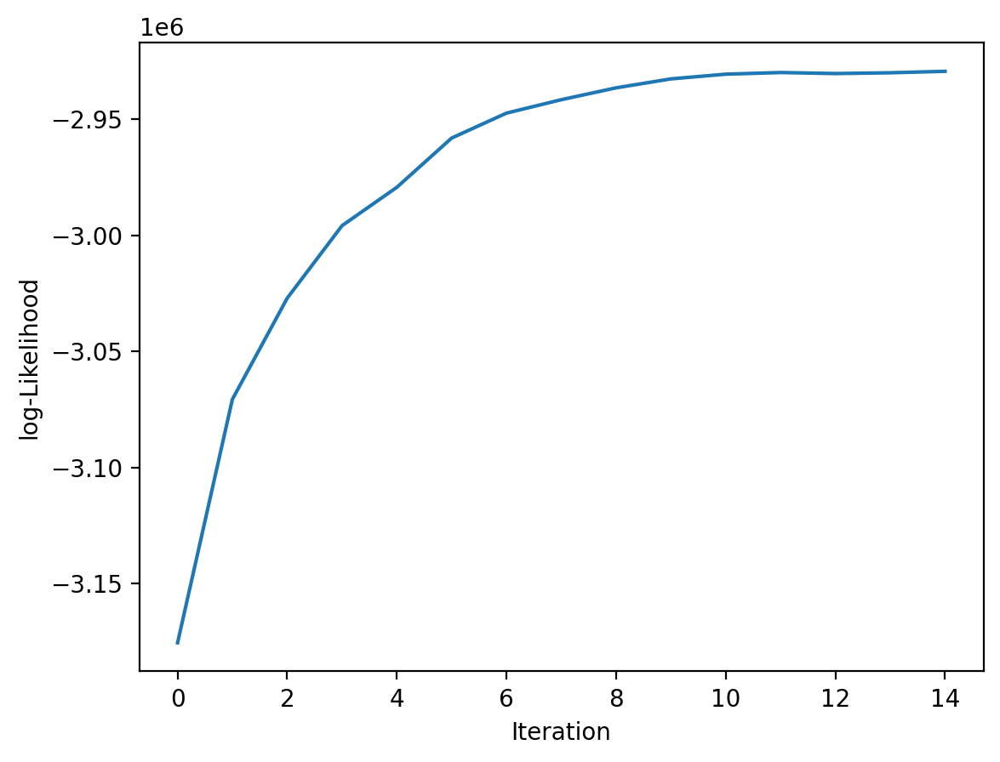

Computing residuals.
Re-fitting with Starlet models for poorly-fit sources.
Fitting Blend model.
Scarlet ran for 5 iterations to logL = -2922665.8768127873


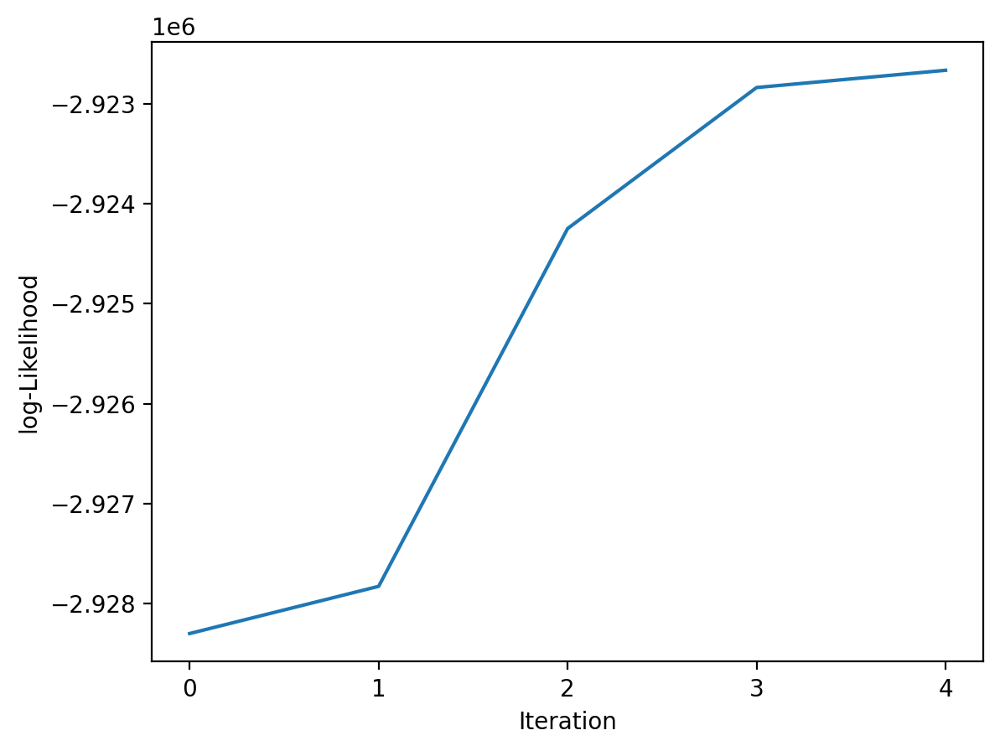

Extracting deblended catalog.


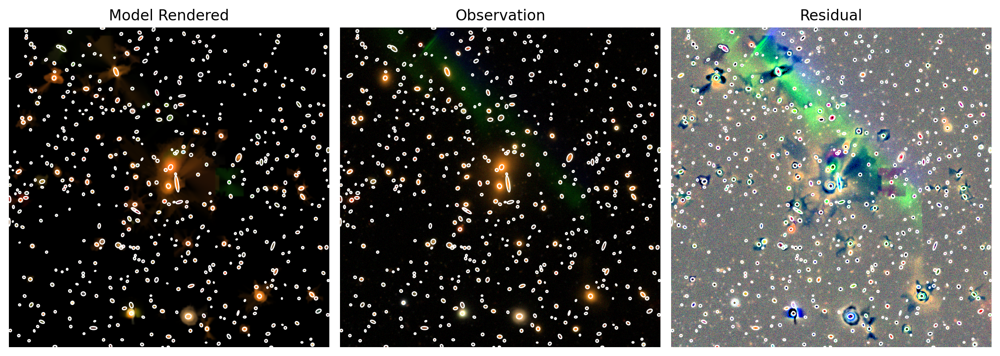


Saved scarlet results as {'img_G': './data/hsc/G-9814-6,6_scarlet_img.fits', 'model_G': './data/hsc/G-9814-6,6_scarlet_model.fits', 'img_R': './data/hsc/R-9814-6,6_scarlet_img.fits', 'model_R': './data/hsc/R-9814-6,6_scarlet_model.fits', 'img_I': './data/hsc/I-9814-6,6_scarlet_img.fits', 'model_I': './data/hsc/I-9814-6,6_scarlet_model.fits', 'segmask': './data/hsc/I-9814-6,6_scarlet_segmask.fits'} 

CPU times: user 12min 21s, sys: 39.9 s, total: 13min 1s
Wall time: 12min 45s


In [5]:
%%time

generate_training_data_example(c=c, plot_scene=True, plot_likelihood=True, cutout_size=[1025, 1025], write_results=True)

### Crowded Field Examples
#### You could also skip this module

Let's show a few more examples in some crowded fields we chose by eye. We can use multiprocessing to speed-up the results.

In [10]:
import multiprocessing
processes = 40


Tract, patch from coord: 8767 (1, 2) 

Loading "/home/paleo2/ASTRODET/HSC/hsc-release.mtk.nao.ac.jp/archive/filetree/pdr2_dud/deepCoadd-results/HSC-G/8767/1,2/calexp-HSC-G-8767-1,2.fits".
Loading "/home/paleo2/ASTRODET/HSC/hsc-release.mtk.nao.ac.jp/archive/filetree/pdr2_dud/deepCoadd-results/HSC-R/8767/1,2/calexp-HSC-R-8767-1,2.fits".
Loading "/home/paleo2/ASTRODET/HSC/hsc-release.mtk.nao.ac.jp/archive/filetree/pdr2_dud/deepCoadd-results/HSC-I/8767/1,2/calexp-HSC-I-8767-1,2.fits".

sigma_obs: 2.0 pixels.
Source catalog found  1 objects
Initializing starlet sources to be fit.
Fitting Blend model.
Scarlet ran for 4 iterations to logL = -2890783.9901106074
Computing residuals.
Extracting deblended catalog.
Exception with source 0


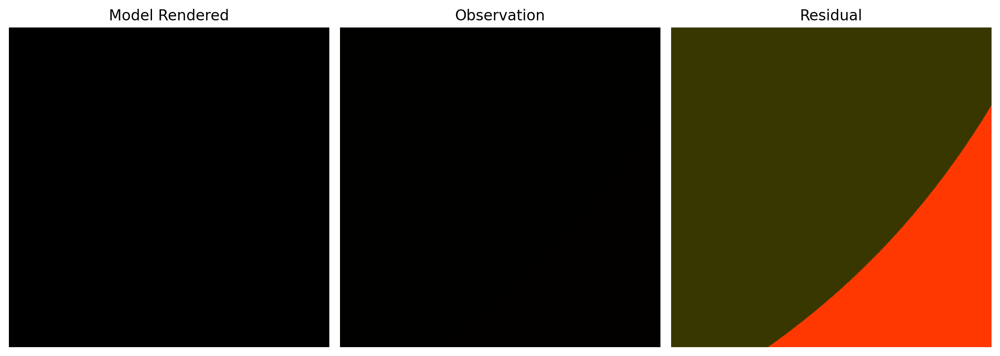

CPU times: user 67.3 ms, sys: 182 ms, total: 249 ms
Wall time: 10.6 s


In [18]:
%%time

#ras = [149.9234]#, 149.8460, 149.9244, 150.4154, 151.2481, 150.1958, 148.4212, 150.7502]
#decs = [3.0282]#, 2.8791, 3.0290, 2.4298, 1.8747, 1.6495, 1.5768, 2.3446]

ras=[37.75146081565182]
decs=[-4.092117222389357]

examples_coords = SkyCoord(ras, decs, unit='deg')


# Pool each image to a CPU
with multiprocessing.Pool(processes=processes) as pool:
    results = pool.map(generate_training_data_example, examples_coords)

### Generate training data

Now that we are satisfied with the results, let's split the tracts and patches into test, training, and validation datatsets.

The function below is similar to the one shown above, but will split up each 4K CCD into chunks before running scarlet in the usual fashion.

In [7]:
def run_scarlet_training(filename, dirpath='./data/hsc', filters=['g', 'r', 'i'], nblocks=4):
    """
    Description.
    
    """
    
    from skimage.util.shape import view_as_blocks
    
    # Get the filter
    f = filename.split(f'calexp-HSC-')[1][0]

    # HSC pixel scale in arcsec/pixel
    ps = 0.17
    # Approximate PSF size in UD field according to HSC DR2 paper is 0.8 arcsec
    sigma_obs = gaussian_fwhm_to_sigma*0.8/ps

    # Point to the HSC data directory
    hsc_dirpath = '/home/paleo2/ASTRODET/HSC/hsc-release.mtk.nao.ac.jp/archive/filetree/pdr2_dud/deepCoadd-results/'

    # Get tract, patch from filename
    s = filename.split(f'calexp-HSC-{f}-')[1].split('.fits')[0]
    tract, patch = s.split('-')
    patch = tuple(map(int, patch.split(',')))

    # Get the HSC data from the file info
    datas = get_hsc_data(dirpath=hsc_dirpath, filters=filters, tract=tract, patch=patch, coord=None, cutout_size=None)

    # Split into blocks
    nfilters = len(filters)
    block_size = [datas.shape[1]//nblocks, datas.shape[2]//nblocks]
        
    datas_blocks = view_as_blocks(datas, block_shape=(nfilters, block_size[0], block_size[1]))
    datas_blocks = datas_blocks.reshape(nblocks**2, nfilters, block_size[0], block_size[1])
    
    for i in range(datas_blocks.shape[0]):
        
        # Get the data block
        datas = datas_blocks[i,:,:,:]

        # Run Scarlet
        out = sc.run_scarlet(datas, filters, sigma_model=1, sigma_obs=sigma_obs, plot_scene=True,
                             max_chi2=1000000, morph_thresh=0.001, starlet_thresh=0.01, stretch=1, Q=5,
                             plot_wavelet=False, plot_likelihood=False, plot_sources=False, add_ellipses=True,
                             add_labels=False, add_boxes=False, lvl = 2, lvl_segmask=5, maskthresh=0.025)

        # Unpack output
        observation, starlet_sources, model_frame, catalog, catalog_deblended, segmentation_masks = out

        filenames = sc.write_scarlet_results(datas, observation, starlet_sources, model_frame,
                                             catalog_deblended, segmentation_masks, dirpath=dirpath,
                                             filters=filters, s=f'{tract}-{patch[0]},{patch[1]}-c{i}')

        print(f'\nSaved scarlet results as {filenames} \n')

#### Define some custom settings

In [8]:
# Point to the HSC data directory
import multiprocessing
hsc_dirpath = '/home/paleo2/ASTRODET/HSC/hsc-release.mtk.nao.ac.jp/archive/filetree/pdr2_dud/deepCoadd-results/'

# Output directory
dirpath = './data/hsc/'

# Filters to use
filters = ['g', 'r', 'i']

# Training, test, and validation dataset ratios
ratios = [1, 0.2, 0.2]

# Number of CPU processes
processes = 80

# Shuffle file order or keep the same?
shuffle_files = True # Set to False for reproducable order
print(processes)

320


#### Split up the dataset

In [12]:
import glob

# Normalize ratios to sum to 1
ratios = ratios / np.sum(ratios)

# Get all HSC data
f = filters[0]
f = f.upper()

files = glob.glob(os.path.join(hsc_dirpath, f'HSC-{f}/**/**/calexp-HSC-{f}-*.fits'), recursive=True)

if shuffle_files:
    # Randomize file order (for testing)
    np.random.shuffle(files)
else:
    # Reproducable file order (for production)
    files = sorted(files)

# Split dataset into training, validation, and test subsets using ratios
ln = len(files)
i_train = int(np.floor(ln*ratios[0]))
i_val = int(np.floor(ln*ratios[1]))
i_test = int(np.floor(ln*ratios[1]))

# Split using index
files_val = files[:i_val]
files_test = files[i_val:i_val + i_test]
files_train = files[i_val + i_test:]

##### Test with a small number #####
files_train = files_train[:10]
files_test = files_test[:10]
#####################################

In [13]:
# View the filenames
type(files_train)

['/home/paleo2/ASTRODET/HSC/hsc-release.mtk.nao.ac.jp/archive/filetree/pdr2_dud/deepCoadd-results/HSC-G/17130/8,5/calexp-HSC-G-17130-8,5.fits',
 '/home/paleo2/ASTRODET/HSC/hsc-release.mtk.nao.ac.jp/archive/filetree/pdr2_dud/deepCoadd-results/HSC-G/8524/7,3/calexp-HSC-G-8524-7,3.fits',
 '/home/paleo2/ASTRODET/HSC/hsc-release.mtk.nao.ac.jp/archive/filetree/pdr2_dud/deepCoadd-results/HSC-G/17271/0,2/calexp-HSC-G-17271-0,2.fits',
 '/home/paleo2/ASTRODET/HSC/hsc-release.mtk.nao.ac.jp/archive/filetree/pdr2_dud/deepCoadd-results/HSC-G/9464/3,6/calexp-HSC-G-9464-3,6.fits',
 '/home/paleo2/ASTRODET/HSC/hsc-release.mtk.nao.ac.jp/archive/filetree/pdr2_dud/deepCoadd-results/HSC-G/9813/6,1/calexp-HSC-G-9813-6,1.fits',
 '/home/paleo2/ASTRODET/HSC/hsc-release.mtk.nao.ac.jp/archive/filetree/pdr2_dud/deepCoadd-results/HSC-G/8524/8,2/calexp-HSC-G-8524-8,2.fits',
 '/home/paleo2/ASTRODET/HSC/hsc-release.mtk.nao.ac.jp/archive/filetree/pdr2_dud/deepCoadd-results/HSC-G/8767/6,2/calexp-HSC-G-8767-6,2.fits',
 '

#### Run Scarlet in parallel for each dataset

Running train with files:
['/home/paleo2/ASTRODET/HSC/hsc-release.mtk.nao.ac.jp/archive/filetree/pdr2_dud/deepCoadd-results/HSC-G/17130/8,5/calexp-HSC-G-17130-8,5.fits', '/home/paleo2/ASTRODET/HSC/hsc-release.mtk.nao.ac.jp/archive/filetree/pdr2_dud/deepCoadd-results/HSC-G/8524/7,3/calexp-HSC-G-8524-7,3.fits', '/home/paleo2/ASTRODET/HSC/hsc-release.mtk.nao.ac.jp/archive/filetree/pdr2_dud/deepCoadd-results/HSC-G/17271/0,2/calexp-HSC-G-17271-0,2.fits', '/home/paleo2/ASTRODET/HSC/hsc-release.mtk.nao.ac.jp/archive/filetree/pdr2_dud/deepCoadd-results/HSC-G/9464/3,6/calexp-HSC-G-9464-3,6.fits', '/home/paleo2/ASTRODET/HSC/hsc-release.mtk.nao.ac.jp/archive/filetree/pdr2_dud/deepCoadd-results/HSC-G/9813/6,1/calexp-HSC-G-9813-6,1.fits', '/home/paleo2/ASTRODET/HSC/hsc-release.mtk.nao.ac.jp/archive/filetree/pdr2_dud/deepCoadd-results/HSC-G/8524/8,2/calexp-HSC-G-8524-8,2.fits', '/home/paleo2/ASTRODET/HSC/hsc-release.mtk.nao.ac.jp/archive/filetree/pdr2_dud/deepCoadd-results/HSC-G/8767/6,2/calexp-HSC-

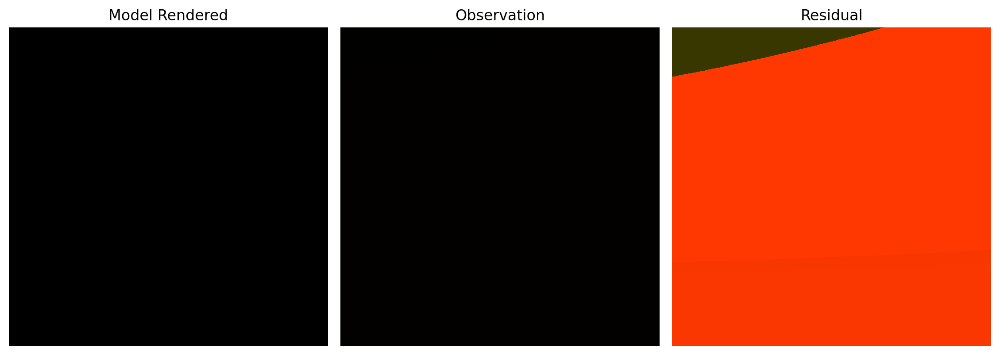

Fitting Blend model.
Scarlet ran for 15 iterations to logL = -3028781.0568403592
Computing residuals.
Extracting deblended catalog.


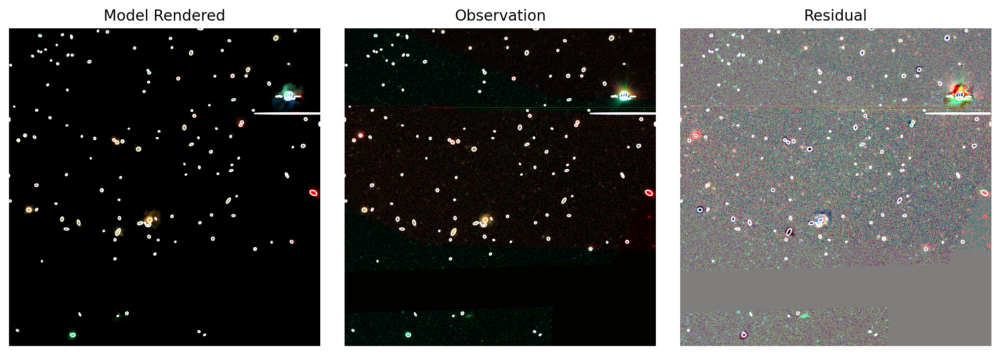

Fitting Blend model.
Fitting Blend model.
Fitting Blend model.
Fitting Blend model.
Fitting Blend model.
Fitting Blend model.
Scarlet ran for 12 iterations to logL = -3123843.341673734
Computing residuals.
Fitting Blend model.
Scarlet ran for 15 iterations to logL = -3080185.0339074046
Computing residuals.
Extracting deblended catalog.
Scarlet ran for 15 iterations to logL = -3406162.8873302164
Computing residuals.
Extracting deblended catalog.
Scarlet ran for 15 iterations to logL = -3289810.966918561
Computing residuals.
Scarlet ran for 15 iterations to logL = -3219073.422529996
Computing residuals.


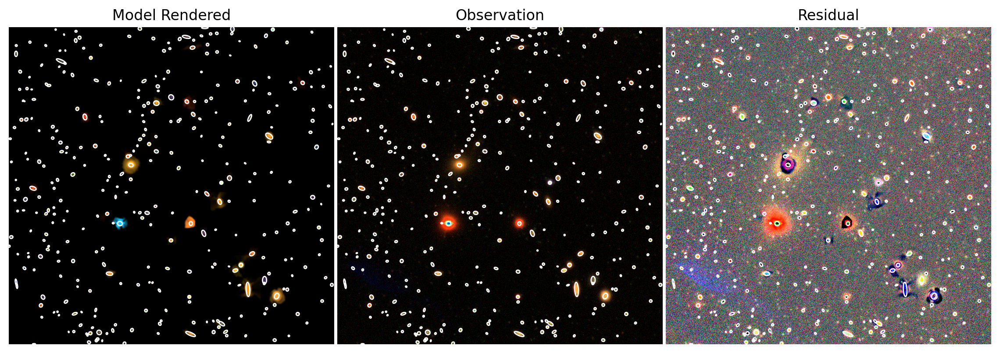

Scarlet ran for 15 iterations to logL = -3482110.373157529
Computing residuals.
Scarlet ran for 15 iterations to logL = -3507760.3205701066
Computing residuals.
Re-fitting with Starlet models for poorly-fit sources.
Fitting Blend model.


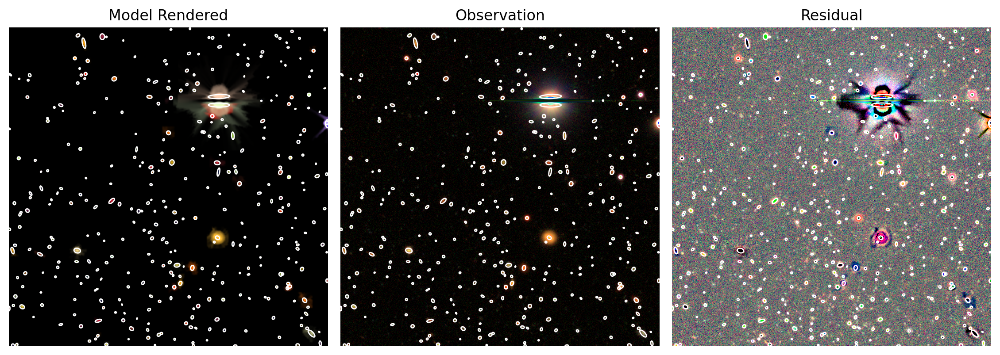

Extracting deblended catalog.
Extracting deblended catalog.
Re-fitting with Starlet models for poorly-fit sources.
Fitting Blend model.
Re-fitting with Starlet models for poorly-fit sources.
Fitting Blend model.
Fitting Blend model.


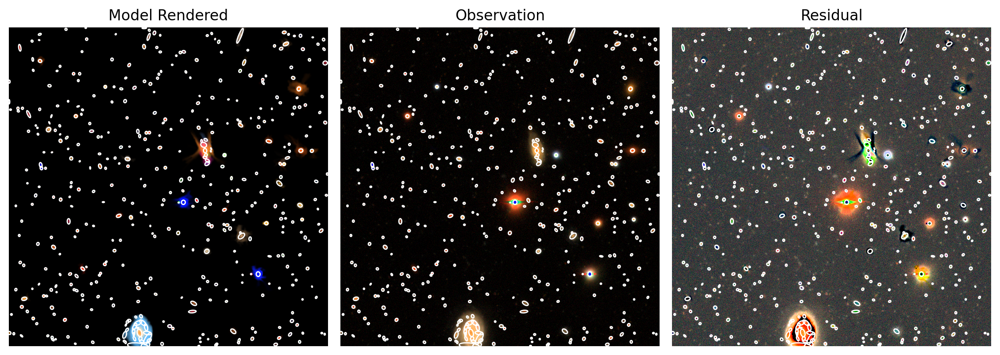

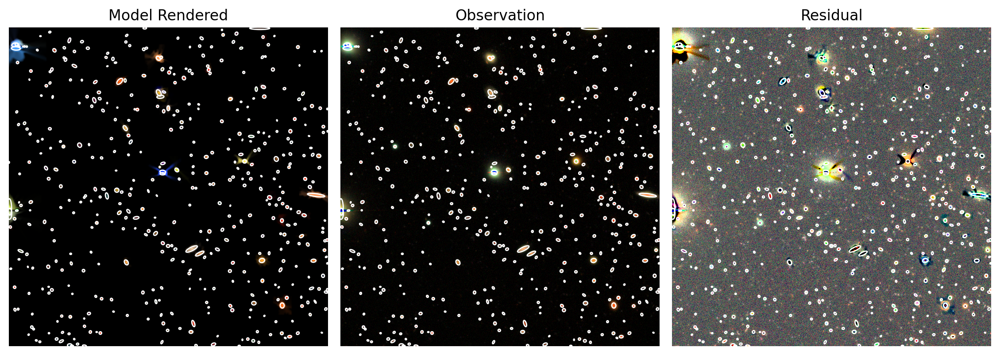

Process ForkPoolWorker-81:
Process ForkPoolWorker-158:
Process ForkPoolWorker-131:
Process ForkPoolWorker-83:
Process ForkPoolWorker-112:
Process ForkPoolWorker-90:
Process ForkPoolWorker-95:
Process ForkPoolWorker-138:
Process ForkPoolWorker-149:
Process ForkPoolWorker-140:
Process ForkPoolWorker-86:
Process ForkPoolWorker-129:
Process ForkPoolWorker-147:
Process ForkPoolWorker-96:
Process ForkPoolWorker-141:
Process ForkPoolWorker-134:
Process ForkPoolWorker-144:
Process ForkPoolWorker-113:
Process ForkPoolWorker-123:
Process ForkPoolWorker-92:
Process ForkPoolWorker-145:
Process ForkPoolWorker-105:
Process ForkPoolWorker-87:
Process ForkPoolWorker-148:
Process ForkPoolWorker-132:
Process ForkPoolWorker-103:
Process ForkPoolWorker-106:
Process ForkPoolWorker-126:
Process ForkPoolWorker-160:
Process ForkPoolWorker-114:
Process ForkPoolWorker-135:
Process ForkPoolWorker-154:
Process ForkPoolWorker-150:
Process ForkPoolWorker-127:
Process ForkPoolWorker-94:
Process ForkPoolWorker-88:
Pr

KeyboardInterrupt: 

In [14]:
import multiprocessing
from itertools import repeat

# Sub-directories for each dataset
dataset_names = ['train', 'test', 'val']
dirpaths_write = [os.path.join(dirpath, d) for d in dataset_names]

# Run scarlet on training and test datasets
for i, f in enumerate([files_train, files_test]): # TODO: Add validation dataset

    print(f'Running {dataset_names[i]} with files:\n{f}')

    args = zip(f, repeat(dirpaths_write[i]))

    # Pool each image to a CPU
    with multiprocessing.Pool(processes=processes) as pool:
        results = pool.starmap(run_scarlet_training, args)

In [35]:
print(int(files_train[0].split('-')[-2]))
print(list(map(int, files_train[0].split('-')[-1][:-5].split(','))))


17130
[8, 5]


Loading "/home/paleo2/ASTRODET/HSC/hsc-release.mtk.nao.ac.jp/archive/filetree/pdr2_dud/deepCoadd-results/HSC-G/8767/1,2/calexp-HSC-G-8767-1,2.fits".
Loading "/home/paleo2/ASTRODET/HSC/hsc-release.mtk.nao.ac.jp/archive/filetree/pdr2_dud/deepCoadd-results/HSC-R/8767/1,2/calexp-HSC-R-8767-1,2.fits".
Loading "/home/paleo2/ASTRODET/HSC/hsc-release.mtk.nao.ac.jp/archive/filetree/pdr2_dud/deepCoadd-results/HSC-I/8767/1,2/calexp-HSC-I-8767-1,2.fits".


(-0.5, 3999.5, -0.5, 3999.5)

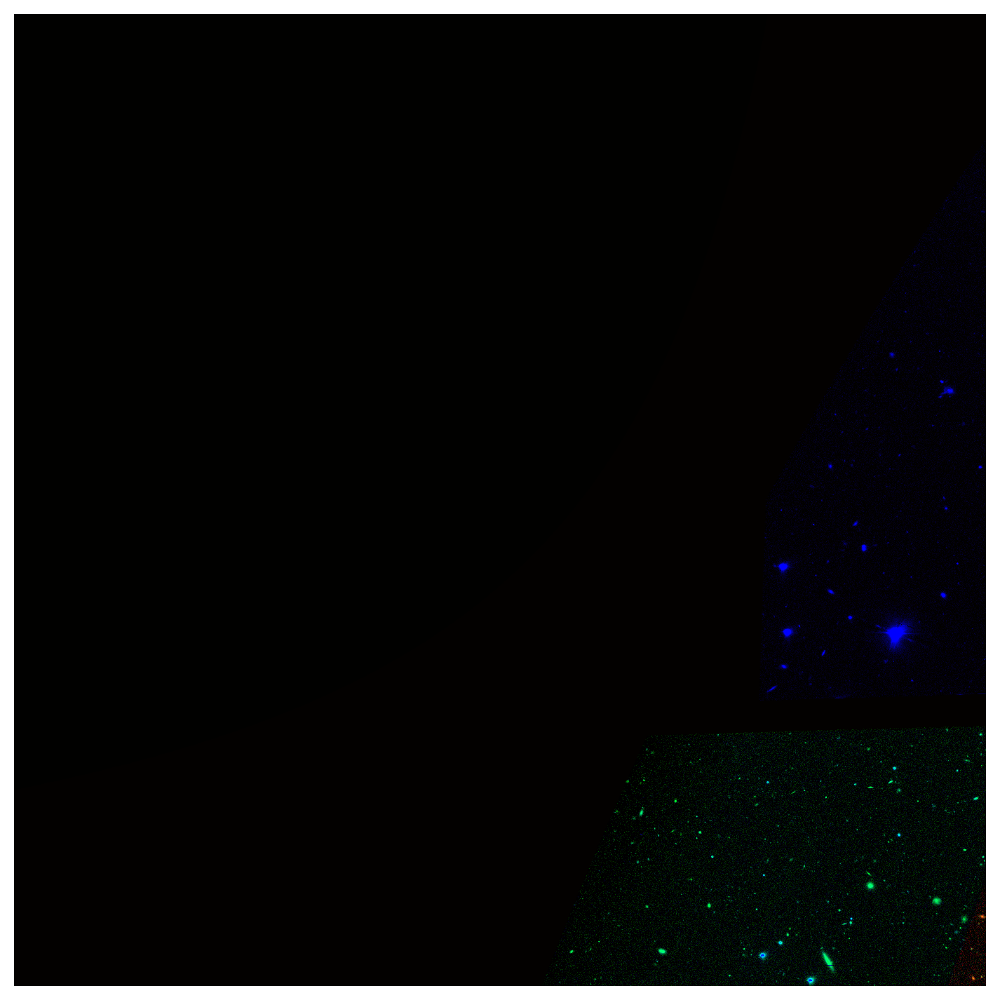

In [12]:
#i=9
hsc_dirpath = '/home/paleo2/ASTRODET/HSC/hsc-release.mtk.nao.ac.jp/archive/filetree/pdr2_dud/deepCoadd-results/'
#tract=int(files_train[i].split('-')[-2])
#patch=list(map(int, files_train[i].split('-')[-1][:-5].split(',')))
cutout_size=[4000, 4000]

tract=8767
patch=[1,2]

datas = get_hsc_data(dirpath=hsc_dirpath, filters=filters, tract=tract, patch=patch, cutout_size=cutout_size)

# Plot image data
fig, ax = plt.subplots(1, 1, figsize=(9,9))
norm = scarlet.display.AsinhMapping(minimum=0, stretch=1, Q=5)
img_rgb = scarlet.display.img_to_rgb(datas, norm=norm)
ax.imshow(img_rgb)
ax.axis('off')

# Find good stretch and Q
#if plot_stretch_Q: fig = sc.plot_stretch_Q(datas);

Loading "/home/paleo2/ASTRODET/HSC/hsc-release.mtk.nao.ac.jp/archive/filetree/pdr2_dud/deepCoadd-results/HSC-G/8767/1,2/calexp-HSC-G-8767-1,2.fits".
Loading "/home/paleo2/ASTRODET/HSC/hsc-release.mtk.nao.ac.jp/archive/filetree/pdr2_dud/deepCoadd-results/HSC-R/8767/1,2/calexp-HSC-R-8767-1,2.fits".
Loading "/home/paleo2/ASTRODET/HSC/hsc-release.mtk.nao.ac.jp/archive/filetree/pdr2_dud/deepCoadd-results/HSC-I/8767/1,2/calexp-HSC-I-8767-1,2.fits".
(3, 4000, 4000)


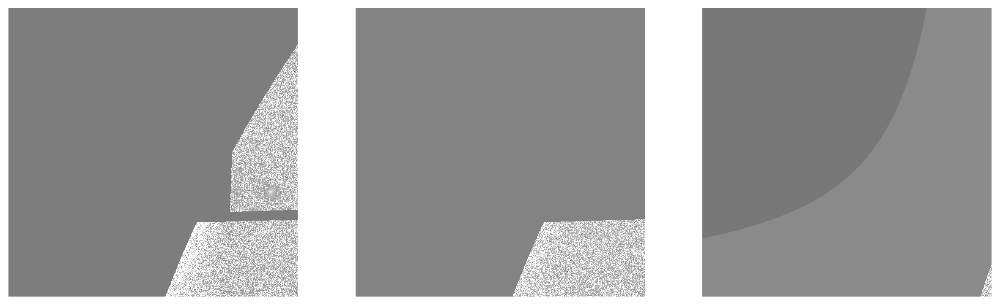

In [20]:
#i=9
from matplotlib.colors import LogNorm
filters = ['g', 'r', 'i']

hsc_dirpath = '/home/paleo2/ASTRODET/HSC/hsc-release.mtk.nao.ac.jp/archive/filetree/pdr2_dud/deepCoadd-results/'
#tract=int(files_train[i].split('-')[-2])
#patch=list(map(int, files_train[i].split('-')[-1][:-5].split(',')))
cutout_size=[4000, 4000]

tract=8767
patch=[1,2]

datas = get_hsc_data(dirpath=hsc_dirpath, filters=filters, tract=tract, patch=patch, cutout_size=cutout_size)
print(datas.shape)
# Plot image data

fig,ax = plt.subplots(1,3,figsize=(15,5))
for i in range(len(filters)):
    ax[i].imshow(datas[i],norm=LogNorm())
    ax[i].axis('off')

# Find good stretch and Q
#if plot_stretch_Q: fig = sc.plot_stretch_Q(datas);

In [23]:
#i=9
from matplotlib.colors import LogNorm
filters = ['g', 'r', 'i']

hsc_dirpath = '/home/paleo2/ASTRODET/HSC/hsc-release.mtk.nao.ac.jp/archive/filetree/pdr2_dud/deepCoadd-results/'
#tract=int(files_train[i].split('-')[-2])
#patch=list(map(int, files_train[i].split('-')[-1][:-5].split(',')))
cutout_size=[4000, 4000]

tract=10055
patch=[0,5]

datas = get_hsc_data(dirpath=hsc_dirpath, filters=filters, tract=tract, patch=patch, cutout_size=cutout_size)
print(datas.shape)
# Plot image data

fig,ax = plt.subplots(1,3,figsize=(15,5))
for i in range(len(filters)):
    ax[i].imshow(datas[i],norm=LogNorm())
    ax[i].axis('off')

# Find good stretch and Q
#if plot_stretch_Q: fig = sc.plot_stretch_Q(datas);

Loading "/home/paleo2/ASTRODET/HSC/hsc-release.mtk.nao.ac.jp/archive/filetree/pdr2_dud/deepCoadd-results/HSC-G/10055/0,5/calexp-HSC-G-10055-0,5.fits".


FileNotFoundError: [Errno 2] No such file or directory: '/home/paleo2/ASTRODET/HSC/hsc-release.mtk.nao.ac.jp/archive/filetree/pdr2_dud/deepCoadd-results/HSC-G/10055/0,5/calexp-HSC-G-10055-0,5.fits'

In [22]:
filters = ['g', 'r', 'i']

# Input coordinate
c = SkyCoord(151.3816, 2.5854, unit='deg')

#add tract,patch args later
def generate_training_data_example2(c=None, dirpath='./data/hsc', plot_image=False, plot_stretch_Q=False, plot_scene=True,
                                   plot_likelihood=False, write_results=False, cutout_size=[2400, 2400]):
    """
    Parameters
    ----------
    c : SkyCoord object
          The ra, dec pointing (single or lists of pointings)
    plot_image : bool
          Whether or not to plot the image
    plot_stretch_Q : bool
          Whether or not to plot different normalizations of your image using the stretch, Q parameters.
    plot_scene : bool
           Whether or not plot scene with scarlet
    plot_likelihood : bool
           Whether or not plot the log likelihood of the scarlet fitting
    write_results : bool
          Whether or not to write results to FITS file
    cutout_size : [int, int]
          Cutout shape of image
          
    Returns
    -------
    The scarlet image test in FITS files.
    
    """
    
    # Get the tract, patch
    tract, patch = get_tract_patch_from_coord(c,f='data/hsc/tracts_patches_DUD-XMM-LSS.txt')
    print('\nTract, patch:', tract, patch, "\n")

    # Point to the HSC data directory
    hsc_dirpath = '/home/paleo2/ASTRODET/HSC/hsc-release.mtk.nao.ac.jp/archive/filetree/pdr2_dud/deepCoadd-results/'

    # Get the HSC data from the file info
    # If you want a cutout centered a coordinate, you must pass the coord argument directly into get_hsc_data
    # Otherwise, you can provide patch and tract and the cutout will be centered on the patch image center

    # Warning: Wall time is O(N^3), where N is the image length or width
    datas = get_hsc_data(dirpath=hsc_dirpath, filters=filters, tract=tract, patch=patch, cutout_size=cutout_size)

    # Plot image data
    if plot_image:
        fig, ax = plt.subplots(1, 1, figsize=(9,9))
        norm = scarlet.display.AsinhMapping(minimum=0, stretch=1, Q=5)
        img_rgb = scarlet.display.img_to_rgb(datas, norm=norm)
        ax.imshow(img_rgb)
        ax.axis('off')

    # Find good stretch and Q
    if plot_stretch_Q: fig = sc.plot_stretch_Q(datas);

    ### Run scarlet on image ###

    # HSC pixel scale in arcsec/pixel
    ps = 0.17
    # Approximate PSF size in UD field according to HSC DR2 paper is 0.8 arcsec
    sigma_obs = gaussian_fwhm_to_sigma*0.8/ps
    print(f'\nsigma_obs: {np.around(sigma_obs, 2)} pixels.')
    
    # Run Scarlet
    out = sc.run_scarlet(datas, filters, sigma_model=1, sigma_obs=sigma_obs, plot_scene=plot_scene,
                         max_chi2=1000000, morph_thresh=0.001, starlet_thresh=0.01, stretch=1, Q=5, 
                         plot_wavelet=False, plot_likelihood=plot_likelihood, plot_sources=False, add_ellipses=True,
                         add_labels=False, add_boxes=False, lvl=30, lvl_segmask=2, maskthresh=0.025)

    # Unpack output
    observation, starlet_sources, model_frame, catalog, catalog_deblended, segmentation_masks = out

    # Save Scarlet data to FITS file
    if write_results:
        filenames = sc.write_scarlet_results(datas, observation, starlet_sources, model_frame, 
                                             catalog_deblended, segmentation_masks, dirpath=dirpath, 
                                             filters=filters, s=f'{tract}-{patch[0]},{patch[1]}')
    
        print(f'\nSaved scarlet results as {filenames} \n')

In [24]:
#ras = [149.9234]#, 149.8460, 149.9244, 150.4154, 151.2481, 150.1958, 148.4212, 150.7502]
#decs = [3.0282]#, 2.8791, 3.0290, 2.4298, 1.8747, 1.6495, 1.5768, 2.3446]

ras=[37.75146081565182]
decs=[-4.092117222389357]

examples_coords = SkyCoord(ras, decs, unit='deg')

# Pool each image to a CPU
with multiprocessing.Pool(processes=processes) as pool:
    results = pool.map(generate_training_data_example2, examples_coords)


Tract, patch: 8767 (1, 2) 

Loading "/home/paleo2/ASTRODET/HSC/hsc-release.mtk.nao.ac.jp/archive/filetree/pdr2_dud/deepCoadd-results/HSC-G/8767/1,2/calexp-HSC-G-8767-1,2.fits".
Loading "/home/paleo2/ASTRODET/HSC/hsc-release.mtk.nao.ac.jp/archive/filetree/pdr2_dud/deepCoadd-results/HSC-R/8767/1,2/calexp-HSC-R-8767-1,2.fits".
Loading "/home/paleo2/ASTRODET/HSC/hsc-release.mtk.nao.ac.jp/archive/filetree/pdr2_dud/deepCoadd-results/HSC-I/8767/1,2/calexp-HSC-I-8767-1,2.fits".

sigma_obs: 2.0 pixels.
Source catalog found  2128 objects
Initializing starlet sources to be fit.


Process ForkPoolWorker-397:
Process ForkPoolWorker-369:
Process ForkPoolWorker-389:
Process ForkPoolWorker-393:
Process ForkPoolWorker-378:
Process ForkPoolWorker-396:
Process ForkPoolWorker-387:
Process ForkPoolWorker-391:
Process ForkPoolWorker-377:
Process ForkPoolWorker-388:
Process ForkPoolWorker-395:
Process ForkPoolWorker-368:
Process ForkPoolWorker-372:
Process ForkPoolWorker-386:
Process ForkPoolWorker-363:
Process ForkPoolWorker-381:
Process ForkPoolWorker-375:
Process ForkPoolWorker-400:
Process ForkPoolWorker-392:
Process ForkPoolWorker-366:
Process ForkPoolWorker-385:
Process ForkPoolWorker-384:
Process ForkPoolWorker-373:
Process ForkPoolWorker-383:
Process ForkPoolWorker-374:
Process ForkPoolWorker-382:
Process ForkPoolWorker-399:
Process ForkPoolWorker-371:
Process ForkPoolWorker-380:
Process ForkPoolWorker-398:
Process ForkPoolWorker-390:
Process ForkPoolWorker-379:
Process ForkPoolWorker-376:
Process ForkPoolWorker-394:
Process ForkPoolWorker-370:
Traceback (most rece

KeyboardInterrupt: 

In [ ]:
# Make the directory readable for other users
!chmod -R 777 ./data/hsc

In [ ]:
import multiprocessing
import itertools

def run(args):
    query, cursor = args
    print("running", query, cursor)

queries = ["foo", "bar", "blub"]
cursor = "whatever"
for i in range(2):
    args = zip(queries, repeat(cursor))
    with multiprocessing.Pool(processes=10) as pool:
        results = pool.map(run, args)